In [1]:
include("speciale_tools.jl")
import JLD
import PyPlot
import Optim

In [2]:

min_vv = -19
max_vv = 4

min_vh = -26
max_vh = -3

min_r = -10
max_r = 1;

min_h = -10
max_h = 100;



In [3]:
folder = "/home/data/simon/processed/177_jutlandS_winter2020/ribe" 

dem_nan = 40
co_gamma = JLD.load(joinpath(folder,"21VV_coher.jld"),"data")[end:-1:1,:]
pre_gamma = JLD.load(joinpath(folder,"23VV_coher.jld"),"data")[end:-1:1,:]

VV_paths = [joinpath(folder,string(i)*"VV_itens.jld") for i=1:3]
VV = [JLD.load(path,"data")[end:-1:1,:] for path in VV_paths]
VH_paths = [joinpath(folder,string(i)*"VH_itens.jld") for i=1:3]
VH = [JLD.load(path,"data")[end:-1:1,:] for path in VH_paths];
heights = JLD.load(joinpath(folder,"heights.jld"),"data")[end:-1:1,:].-dem_nan;

In [4]:
#### 


filt = SlcUtil.temporal_filter([VV[1],VH[1]],5);

VV = SlcUtil.temporal_filter(VV,5);
VH = SlcUtil.temporal_filter(VH,5);

VV[1] = filt[1]
VH[1] = filt[2];

In [11]:
import Optim


LsqFit.@. gauss_model(x, p) = p[1]*exp(-0.5*((x-p[2])/p[3])^2) 


function sse_water_fit(flood_band,change_band,seed_mask,bm_mask, p_water,w_sum,edges,y, rg_thresholds)
    
    rg_mask = (flood_band .<rg_thresholds[1]) .& (change_band.<rg_thresholds[2]) .| seed_mask 
    rg_result, steps = region_growing(seed_mask,rg_mask);
    
    data = reshape(flood_band,:)[reshape(rg_mask.&bm_mask,:)];
    
    h = StatsBase.fit(StatsBase.Histogram, data,edges)
    w_sel = h.weights./w_sum;
    w_water_est = gauss_model(y,p_water)
    SSE = (w_sel .- w_water_est)'*(w_sel .- w_water_est)
    return SSE
end


function find_y_seed(p_fit,y,ratio = 0.99)
    p_water = p_fit[[1,3,5]]
    p_nonwater = p_fit[[2,4,6]]
    ratio = gauss_model(y,p_water)./bimodal_gauss_model(y, p_fit)
    y_seed = y[y.>p_water[2]][ findfirst(ratio[y.>p_water[2]].<0.99)]
    return y_seed
end


function HSBA_floodmask(flood_band,ref_band)
    change_band = flood_band.-ref_band;
    bm_mask_flood = find_bimodal_tiles(flood_band);
    bm_mask_change = find_bimodal_tiles(change_band);
    bm_mask = bm_mask_change.&bm_mask_flood
    data = reshape(flood_band,:)[reshape(bm_mask,:)]
    p_fit,y,w,edges, w_sum = fit_bimodal_gauss(data,round(Int64,length(data)/50))

    y_seed =find_y_seed(p_fit,y)
    seed_mask = flood_band .<y_seed

    t_0 = [y_seed+1, -1]
    res = Optim.optimize(
        t -> sse_water_fit(flood_band,change_band,seed_mask,bm_mask, p_fit[[1,3,5]],w_sum,edges,y, t), 
        t_0; autodiff = :forward)

    rg_thresholds = res.minimizer
    rg_mask = (flood_band .<rg_thresholds[1]) .& (change_band.<rg_thresholds[2]) .| seed_mask 
    flood_mask, steps = region_growing(seed_mask,rg_mask);

    seed_mask_ref = ref_band .<y_seed
    rg_mask_ref = (ref_band .<rg_thresholds[1])
    ref_mask, steps = region_growing(seed_mask_ref,rg_mask_ref);

    final_mask = flood_mask .& (ref_mask .!=true);
    
    return final_mask, [y_seed,rg_thresholds...]
end

HSBA_floodmask (generic function with 1 method)

## flood VV

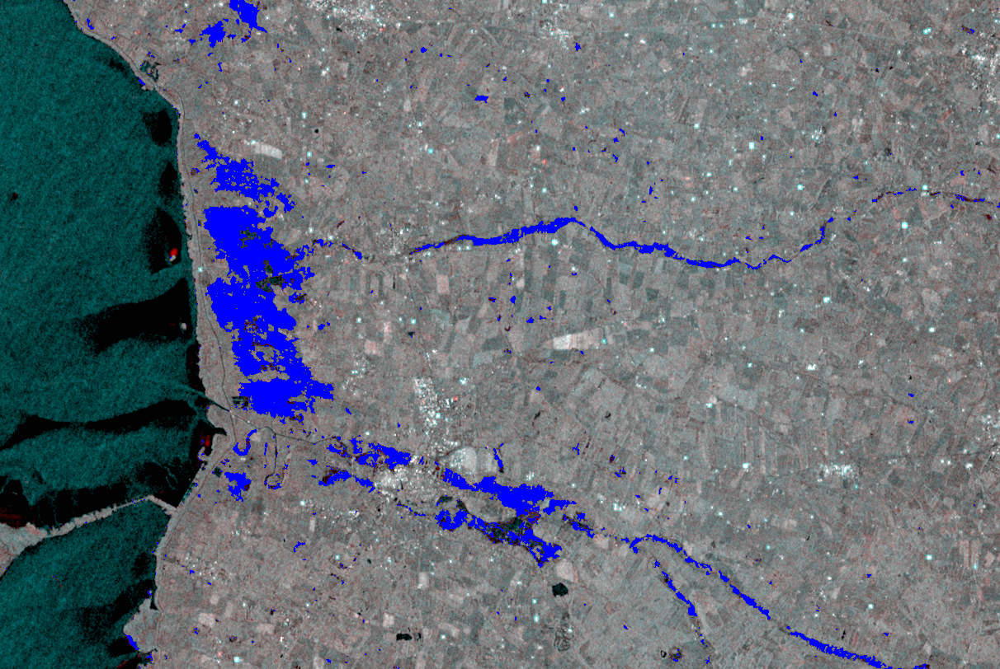

In [13]:
flood_band = 10 .*log10.(VV[1][:,500:end]);
ref_band = 10 .*log10.(VV[3][:,500:end]);

final_mask, thresholds = HSBA_floodmask(flood_band,ref_band)

bands = [elem[:,500:end] for elem in VV]
img = pretty_img(bands ,min_vv,max_vv);
add_mask(img, final_mask ,(0,0,1))

## Flood VH

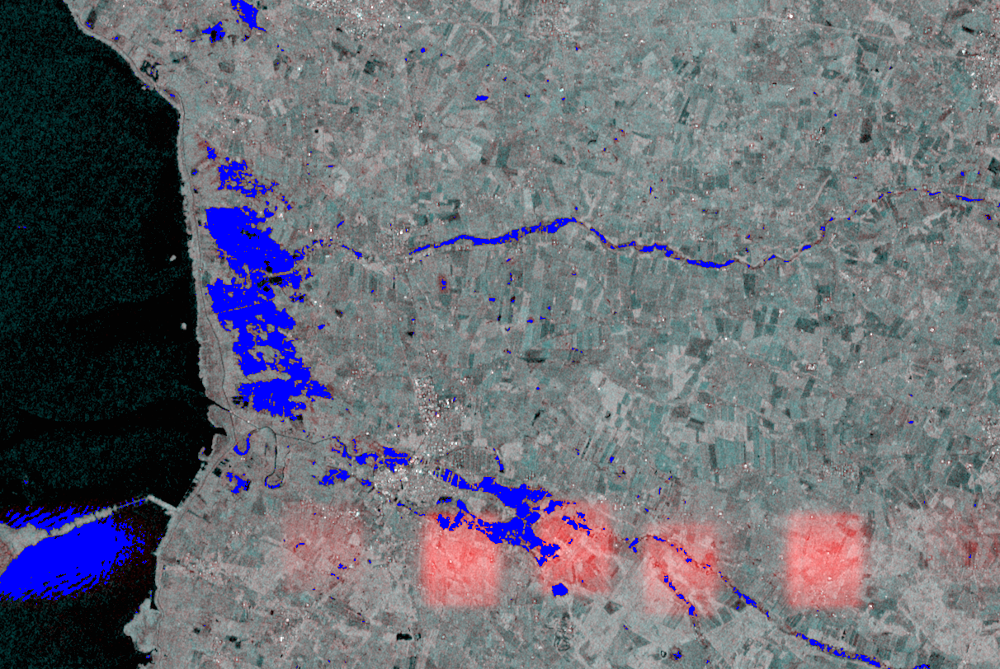

In [12]:
flood_band = 10 .*log10.(VH[1][:,500:end]);
ref_band = 10 .*log10.(VH[3][:,500:end]);

final_mask, thresholds = HSBA_floodmask(flood_band,ref_band)

bands = [elem[:,500:end] for elem in VH]
img = pretty_img(bands ,min_vh,max_vh);
add_mask(img, final_mask ,(0,0,1))

### Fulll VV

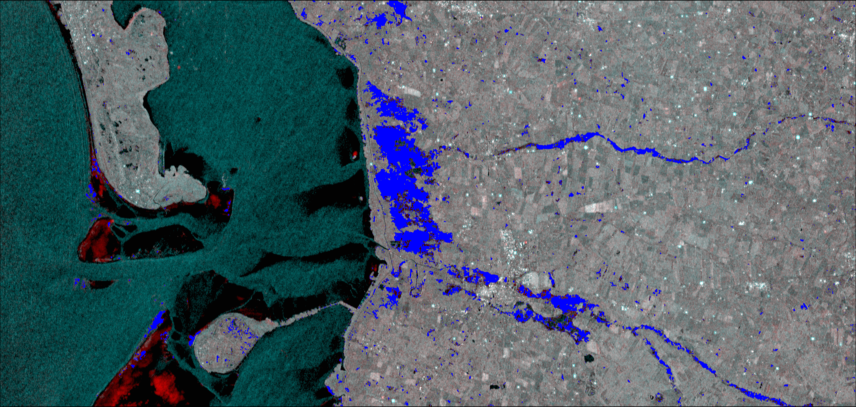

In [14]:
flood_band = 10 .*log10.(VV[1]);
ref_band = 10 .*log10.(VV[3]);

final_mask, thresholds = HSBA_floodmask(flood_band,ref_band)

img = pretty_img(VV ,min_vv,max_vv);
add_mask(img, final_mask ,(0,0,1))

## Full VH

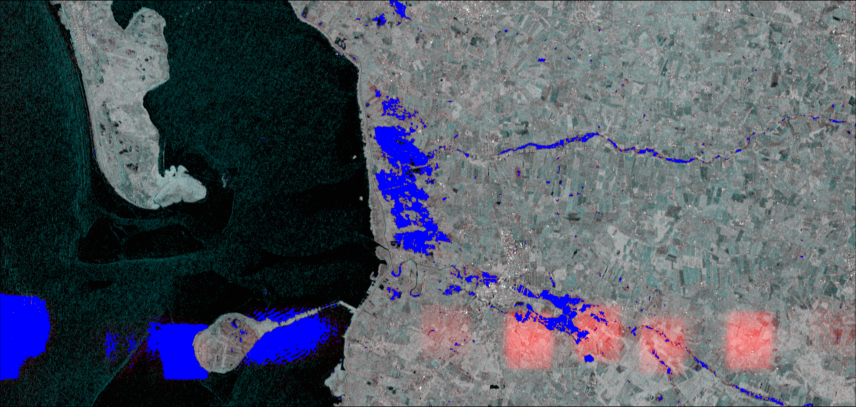

In [15]:
flood_band = 10 .*log10.(VH[1]);
ref_band = 10 .*log10.(VH[3]);

final_mask, thresholds = HSBA_floodmask(flood_band,ref_band)

img = pretty_img(VH,min_vh,max_vh);
add_mask(img, final_mask ,(0,0,1))

In [20]:
bm_mask_flood = find_bimodal_tiles(flood_band);
bm_mask_change = find_bimodal_tiles(change_band);
bm_mask = bm_mask_change.&bm_mask_flood
data = reshape(flood_band,:)[reshape(bm_mask,:)]
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(data,round(Int64,length(data)/50))

y_seed =find_y_seed(p_fit)
seed_mask = flood_band .<y_seed

t_0 = [y_seed+1, -1]
res = Optim.optimize(t -> sse_water_fit(flood_band,change_band,seed_mask,bm_mask, p_fit[[1,3,5]],w_sum, t), 
    t_0; autodiff = :forward)

rg_thresholds = res.minimizer
rg_mask = (flood_band .<rg_thresholds[1]) .& (change_band.<rg_thresholds[2]) .| seed_mask 
flood_mask, steps = region_growing(seed_mask,rg_mask);

seed_mask_ref = ref_band .<y_seed
rg_mask_ref = (ref_band .<rg_thresholds[1])
ref_mask, steps = region_growing(seed_mask_ref,rg_mask_ref);

final_mask = flood_mask .& (ref_mask .!=true);

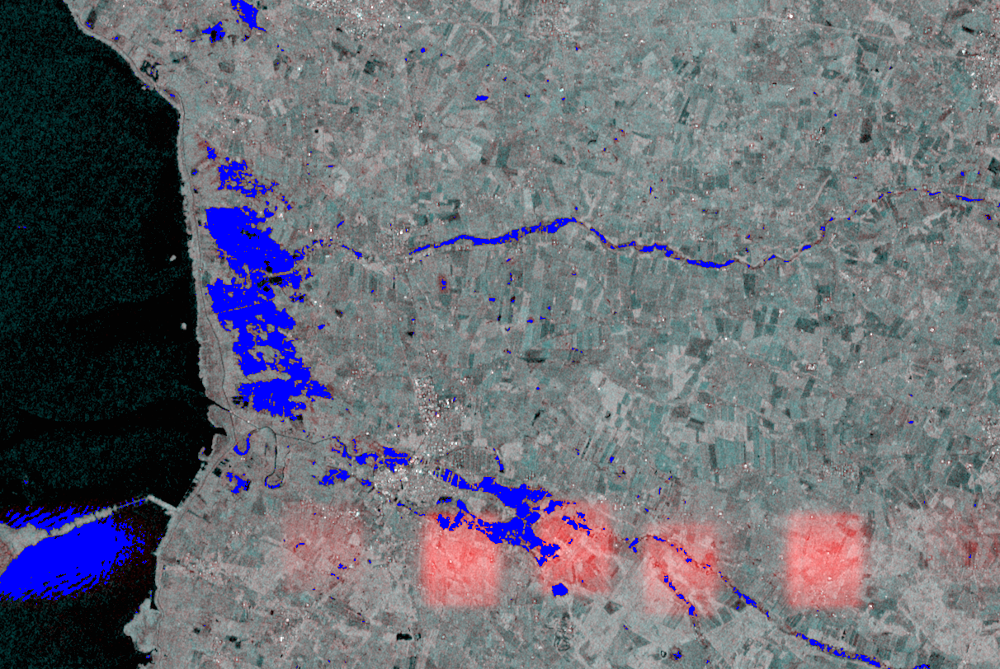

In [17]:

bands = [elem[:,500:end] for elem in VH]
img = pretty_img(bands ,min_vh,max_vh);
add_mask(img, final_mask ,(0,0,1))

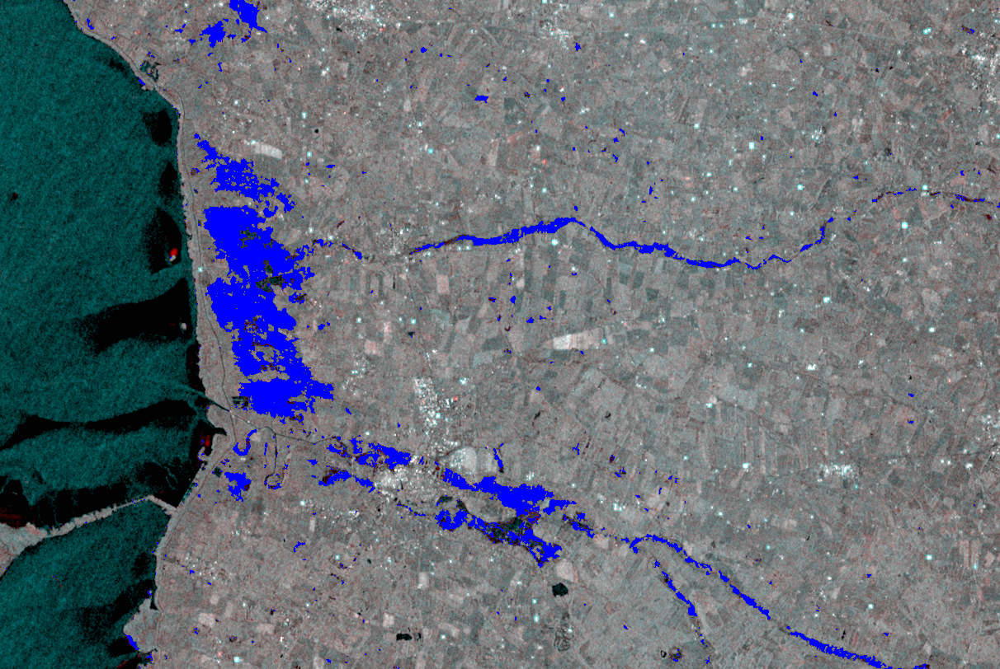

In [21]:

bands = [elem[:,500:end] for elem in VV]
img = pretty_img(bands ,min_vv,max_vv);
add_mask(img, final_mask ,(0,0,1))

┌ Info: Precompiling ImageMagick [6218d12a-5da1-5696-b52f-db25d2ecc6d1]
└ @ Base loading.jl:1273


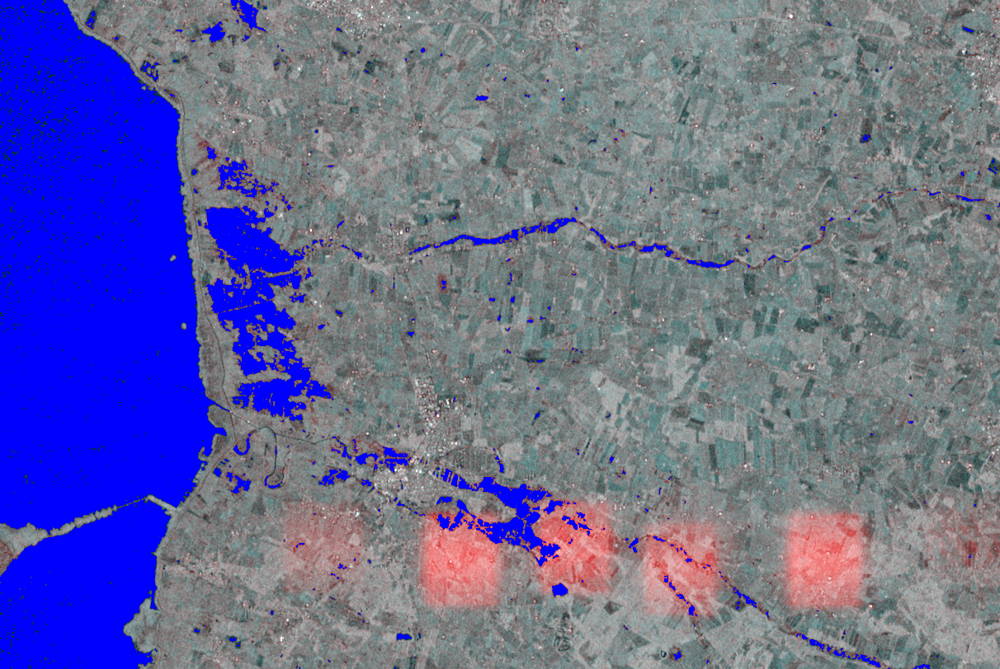

In [10]:
bands = [elem[:,500:end] for elem in VH]
img = pretty_img(bands ,min_vh,max_vh);
add_mask(img, flood_mask ,(0,0,1))

In [13]:
seed_mask_ref = ref_band .<y_seed
rg_mask_ref = (ref_band .<rg_thresholds[1])
ref_mask, steps = region_growing(seed_mask_ref,rg_mask_ref);

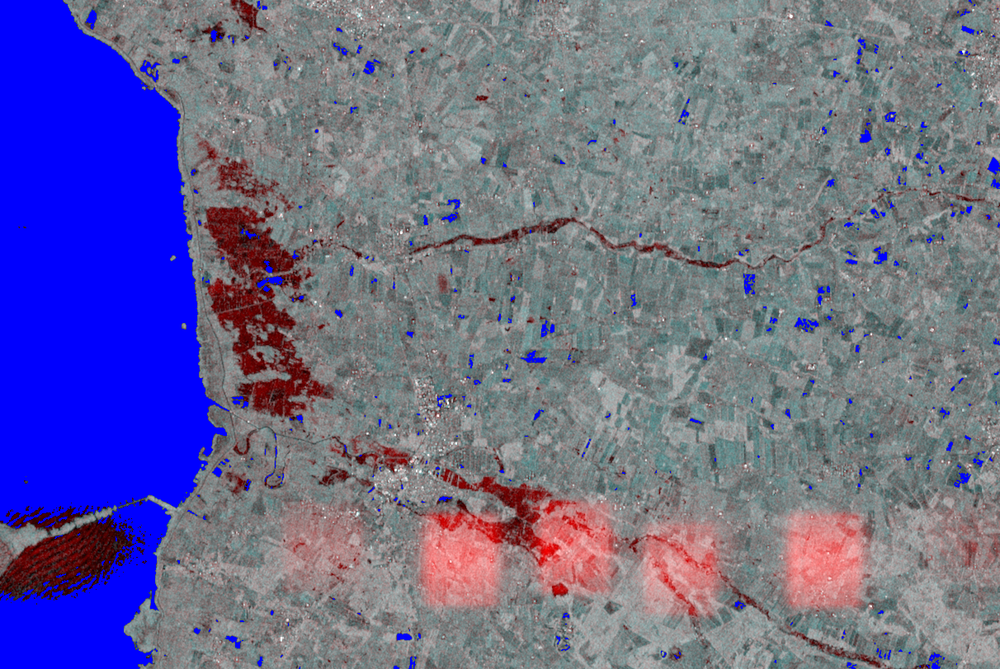

In [14]:
bands = [elem[:,500:end] for elem in VH]
img = pretty_img(bands ,min_vh,max_vh);
add_mask(img, ref_mask ,(0,0,1))

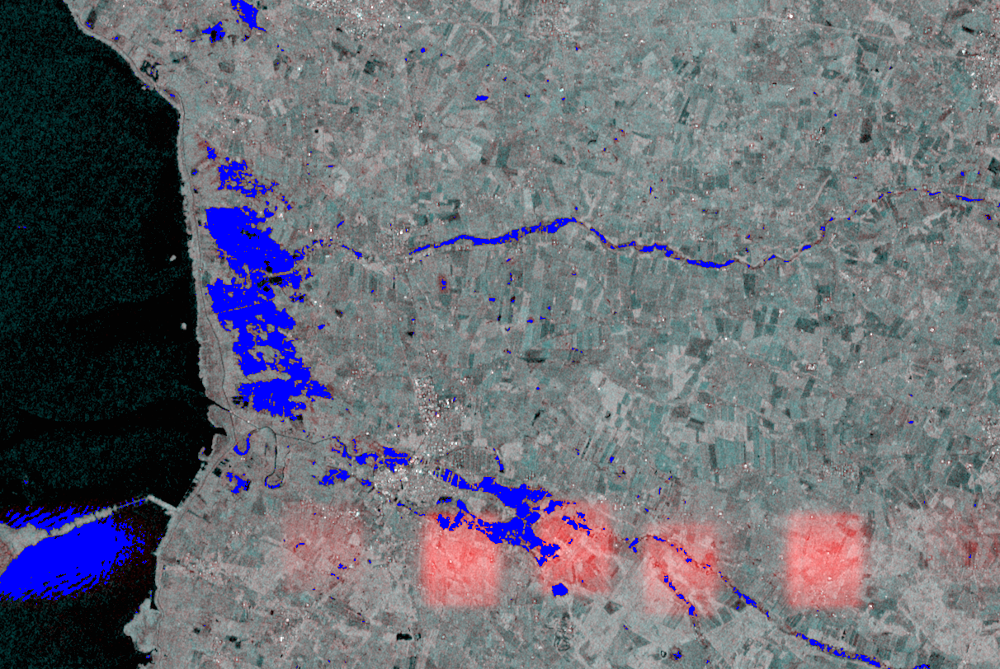

In [15]:
final_mask = flood_mask .& (ref_mask .!=true);
bands = [elem[:,500:end] for elem in VH]
img = pretty_img(bands ,min_vh,max_vh);
add_mask(img, final_mask ,(0,0,1))

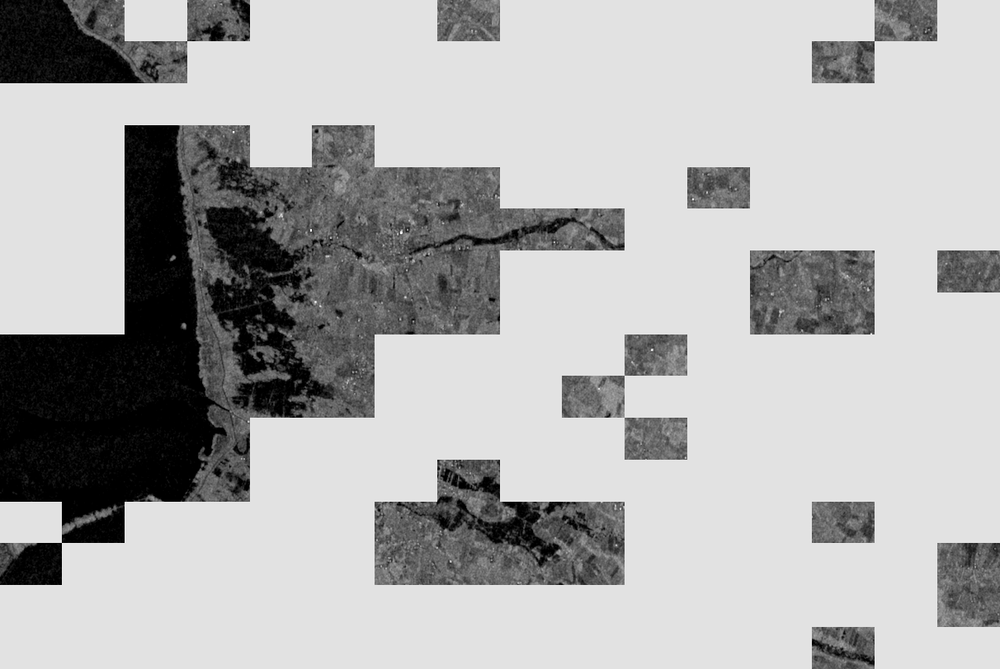

In [7]:
bm_mask_flood = find_bimodal_tiles(flood_band);
img = Colors.Gray.(scale_img(flood_band,min_vh,max_vh));
img = add_mask(img, (bm_mask_flood .!=true) ,(1,1,0))

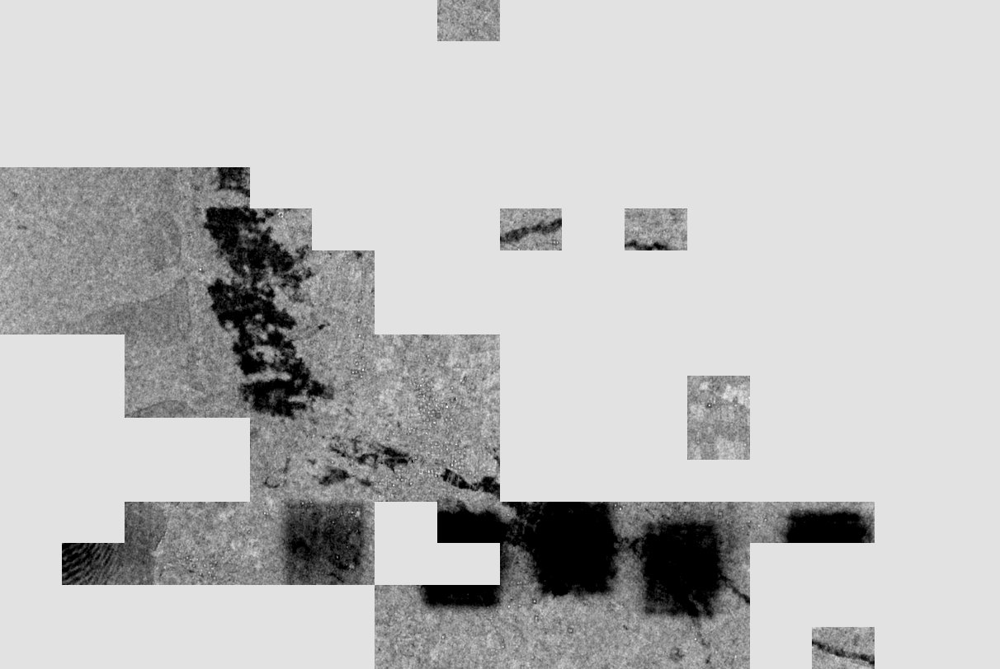

In [8]:
img = Colors.Gray.(scale_img(change_band,-6,6))


bm_mask_change = find_bimodal_tiles(change_band);
img = Colors.Gray.(scale_img(change_band,-8,8));
img = add_mask(img, (bm_mask_change .!=true) ,(1,1,0))

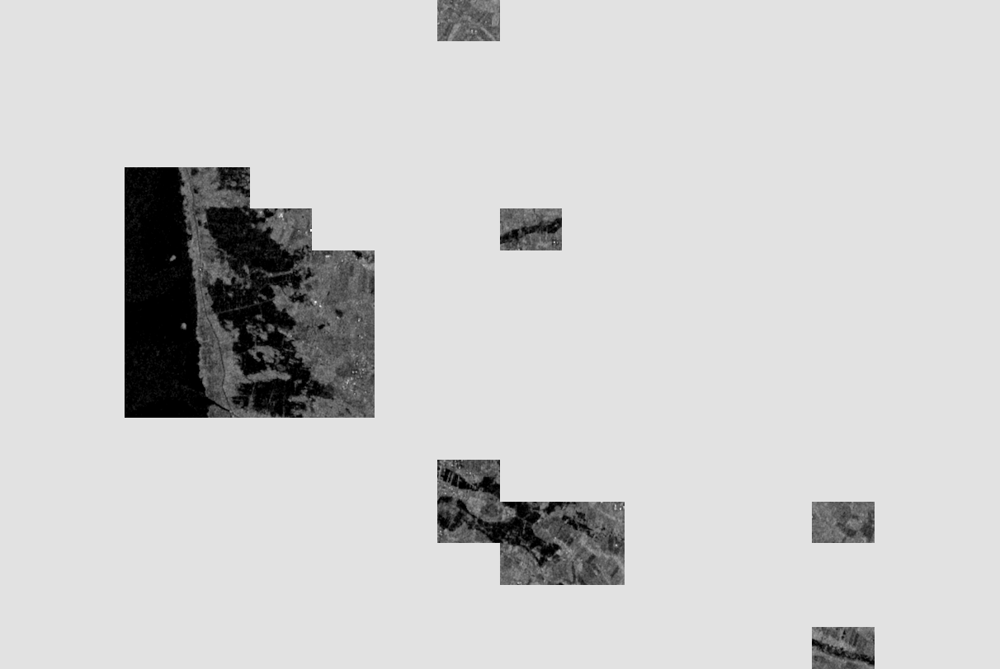

In [9]:
img = Colors.Gray.(scale_img(flood_band,min_vh,max_vh));
img = add_mask(img, ((bm_mask_change.&bm_mask_flood) .!=true) ,(1,1,0))

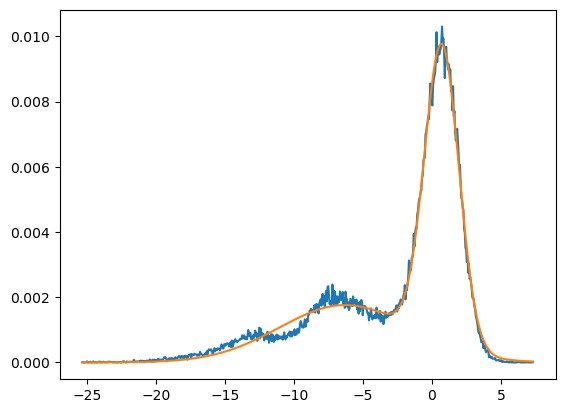

1-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f8b73d428e0>

In [10]:
data = reshape(change_band,:)[reshape((bm_mask_change.&bm_mask_flood),:)]
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(data,round(Int64,length(data)/200),10000)

PyPlot.figure()
PyPlot.plot(y,w)
PyPlot.plot(y, bimodal_gauss_model(y, p_fit) )

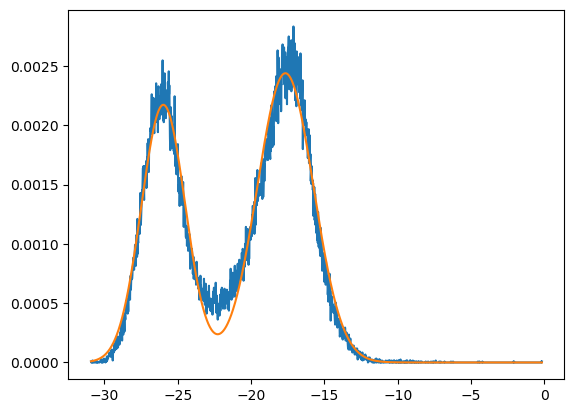

1-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f8b094dcb20>

In [53]:
bm_mask = bm_mask_change.&bm_mask_flood
data = reshape(flood_band,:)[reshape(bm_mask,:)]
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(data,round(Int64,length(data)/50),10000)

PyPlot.figure()
PyPlot.plot(y,w)
PyPlot.plot(y, bimodal_gauss_model(y, p_fit) )

In [54]:
LsqFit.@. gauss_model(x, p) = p[1]*exp(-0.5*((x-p[2])/p[3])^2) 


gauss_model (generic function with 1 method)

In [55]:
p_water = p_fit[[1,3,5]]
p_nonwater = p_fit[[2,4,6]]
ratio = gauss_model(y,p_water)./bimodal_gauss_model(y, p_fit)
y_seed = y[y.>p_water[2]][ findfirst(ratio[y.>p_water[2]].<0.99)]


-24.03

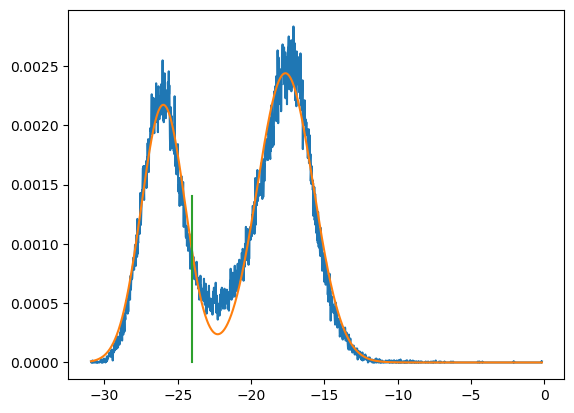

1-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f8b094bab80>

In [56]:
PyPlot.figure()
PyPlot.plot(y,w)
PyPlot.plot(y, bimodal_gauss_model(y, p_fit) )
PyPlot.plot(ones(8)*(y_seed), collect(0:0.0002:0.0014))

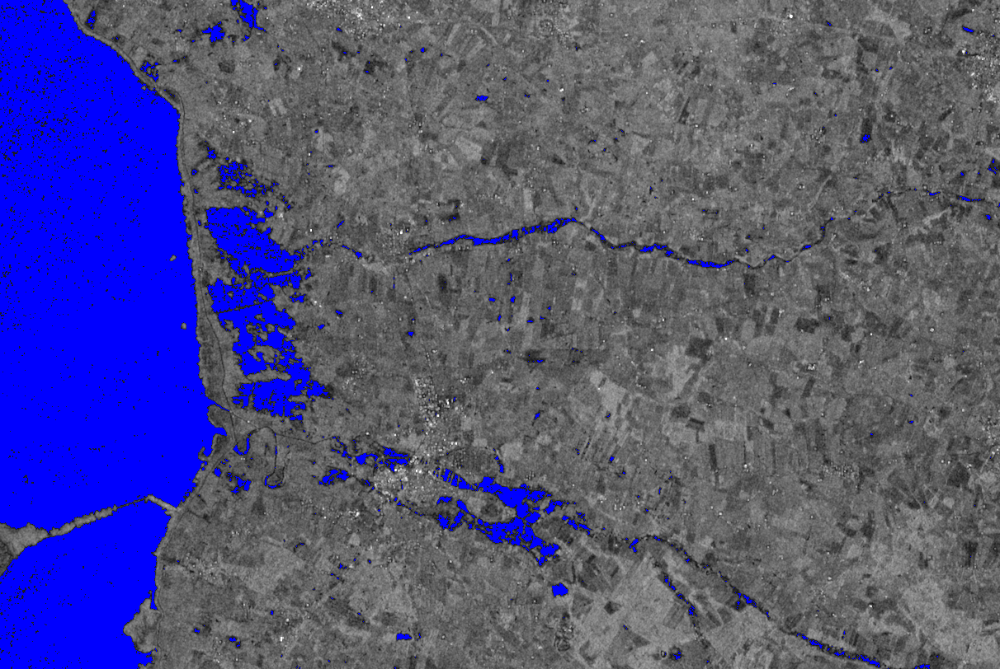

In [57]:

img = Colors.Gray.(scale_img(flood_band,min_vh,max_vh));
img = convert.(Colors.RGB{Float32},img)
img = add_mask(img, flood_band .<y_seed ,(0,0,1))

In [58]:
water_mask = flood_band .<y_seed;


In [69]:
data = reshape(flood_band,:)[reshape(water_mask .& bm_mask,:)];
h = StatsBase.fit(StatsBase.Histogram, data,edges)
w_sel = h.weights./w_sum;
w_water_est = gauss_model(y,p_water)
sse = (w_sel .- w_water_est)'*(w_sel .- w_water_est)

2.536811376185179e-5

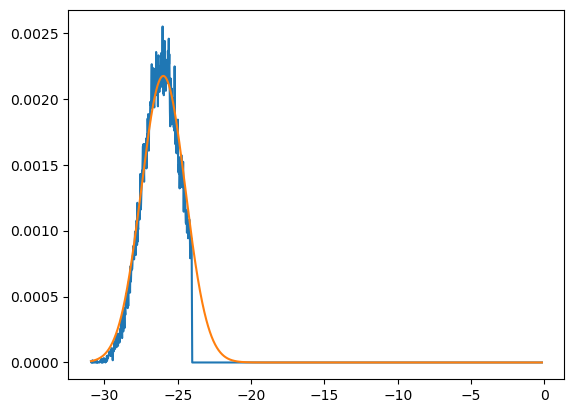

1-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f8b09709e20>

In [70]:
PyPlot.figure()
PyPlot.plot(y,w_sel)
PyPlot.plot(y, w_water_est  )

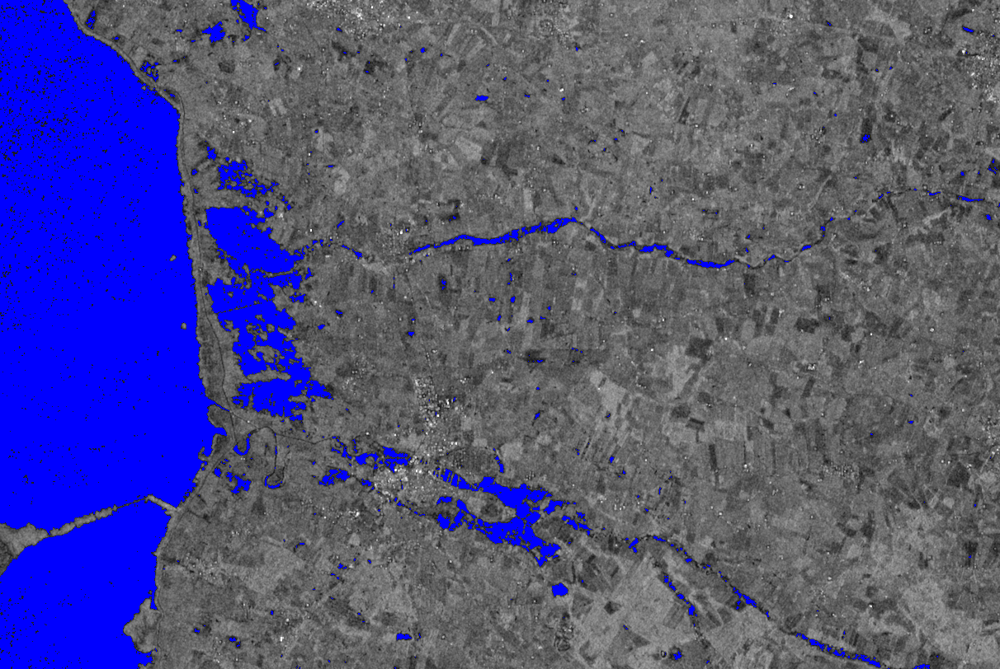

In [71]:
rg_mask = ((flood_band .<-23) .& (change_band.<-1)) .| water_mask ;

rg_result, steps = region_growing(water_mask,rg_mask);
img = Colors.Gray.(scale_img(flood_band,min_vh,max_vh));
img = convert.(Colors.RGB{Float32},img)
add_mask(img, rg_result ,(0,0,1))

In [72]:
data = reshape(flood_band,:)[reshape(rg_mask.&bm_mask,:)];
h = StatsBase.fit(StatsBase.Histogram, data,edges)
w_sel = h.weights./w_sum;
w_water_est = gauss_model(y,p_water)
sse = (w_sel .- w_water_est)'*(w_sel .- w_water_est)


7.328568870725075e-6

### Function 

In [74]:
import Optim

function sse_water_fit(flood_band,change_band,y_seed,bm_mask, p_water,w_sum, rg_thresholds)
    seed_mask = flood_band .<y_seed
    rg_mask = (flood_band .<rg_thresholds[1]) .& (change_band.<rg_thresholds[2]) .| seed_mask 
    rg_result, steps = region_growing(seed_mask,rg_mask);
    
    data = reshape(flood_band,:)[reshape(rg_mask.&bm_mask,:)];
    
    h = StatsBase.fit(StatsBase.Histogram, data,edges)
    w_sel = h.weights./w_sum;
    w_water_est = gauss_model(y,p_water)
    SSE = (w_sel .- w_water_est)'*(w_sel .- w_water_est)
    return SSE
end
       



sse_water_fit (generic function with 1 method)

In [88]:
sse_water_fit(flood_band,change_band,y_seed,bm_mask, p_water,w_sum, [-23,-1])

7.328568870725075e-6

In [77]:
sse_water_fit(flood_band,change_band,y_seed,bm_mask, p_water,w_sum, [-22,-1])

1.0736576981496349e-5

In [81]:
sse_water_fit(flood_band,change_band,y_seed,bm_mask, p_water,w_sum, [-24,-3])

2.4328964787425516e-5

In [89]:
import Pkg; Pkg.add("Optim")

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
Fetching: [========================================>]  100.0 %.0 % [========>                                ]  19.7 %]  39.3 %               ]  61.1 %=================================>       ]  80.8 % Resolving package versions...
 Installed PositiveFactorizations ─────── v0.2.3
 Installed CompilerSupportLibraries_jll ─ v0.3.3+0
 Installed ImageMagick_jll ────────────── v6.9.10-12+1
 Installed LineSearches ───────────────── v7.0.1
 Installed Optim ──────────────────────── v0.20.1
  Updating `~/.julia/environments/v1.3/Project.toml`
  [429524aa] + Optim v0.20.1
  Updating `~/.julia/environments/v1.3/Manifest.toml`
  [e66e0078] ↑ CompilerSupportLibraries_jll v0.3.2+0 ⇒ v0.3.3+0
  [c73af94c] ↑ ImageMagick_jll v6.9.10-12+0 ⇒ v6.9.10-12+1
  [d3d80556] + LineSearches v7.0.1
  [429524aa] + Optim v0.20.1
  [85a6dd25] + PositiveFactorizations v0.2.3


In [90]:
import Optim

┌ Info: Precompiling Optim [429524aa-4258-5aef-a3af-852621145aeb]
└ @ Base loading.jl:1273


In [92]:
t_0 = [y_seed+1, -1]
res = Optim.optimize(t -> sse_water_fit(flood_band,change_band,y_seed,bm_mask, p_water,w_sum, t), 
    t_0; autodiff = :forward)

 * Status: success

 * Candidate solution
    Minimizer: [-2.28e+01, -1.17e+00]
    Minimum:   7.112584e-06

 * Found with
    Algorithm:     Nelder-Mead
    Initial Point: [-2.30e+01, -1.00e+00]

 * Convergence measures
    √(Σ(yᵢ-ȳ)²)/n ≤ 1.0e-08

 * Work counters
    Seconds run:   11  (vs limit Inf)
    Iterations:    10
    f(x) calls:    30


In [93]:
t_0 = [y_seed+1, -1]
res = Optim.optimize(t -> sse_water_fit(flood_band,change_band,y_seed,bm_mask, p_water,w_sum, t), t_0)

 * Status: success

 * Candidate solution
    Minimizer: [-2.28e+01, -1.17e+00]
    Minimum:   7.112584e-06

 * Found with
    Algorithm:     Nelder-Mead
    Initial Point: [-2.30e+01, -1.00e+00]

 * Convergence measures
    √(Σ(yᵢ-ȳ)²)/n ≤ 1.0e-08

 * Work counters
    Seconds run:   11  (vs limit Inf)
    Iterations:    10
    f(x) calls:    30


In [97]:
res.minimizer

2-element Array{Float64,1}:
 -22.828027343749998 
  -1.1674560546875001

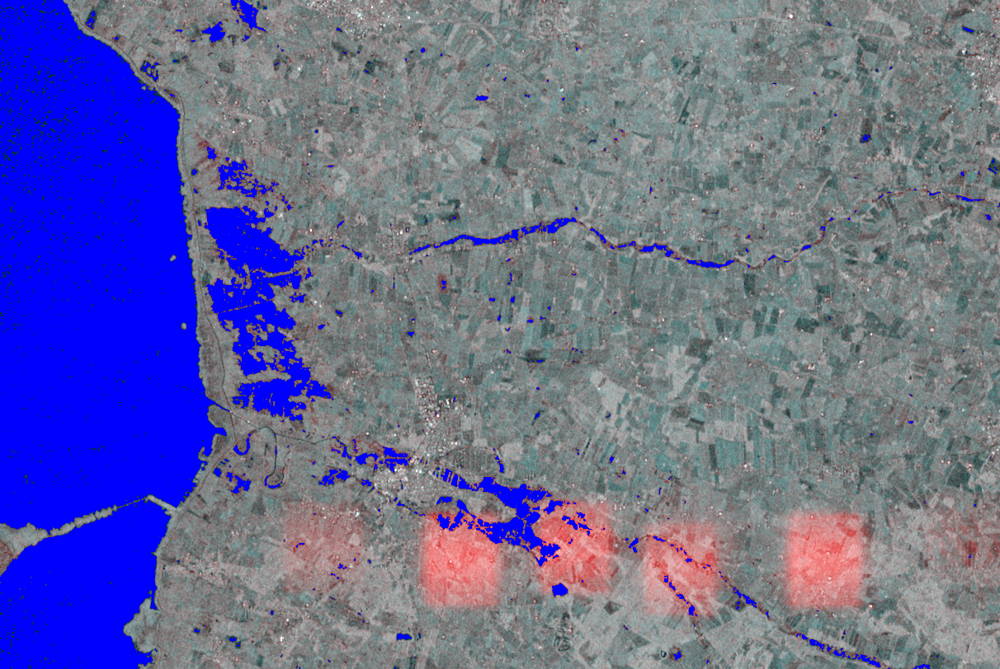

In [108]:
rg_thresholds = res.minimizer
seed_mask = flood_band .<y_seed
rg_mask = (flood_band .<rg_thresholds[1]) .& (change_band.<rg_thresholds[2]) .| seed_mask 
rg_result, steps = region_growing(seed_mask,rg_mask);
bands = [elem[:,500:end] for elem in VH]
img = pretty_img(bands ,min_vh,max_vh);
add_mask(img, rg_result ,(0,0,1))

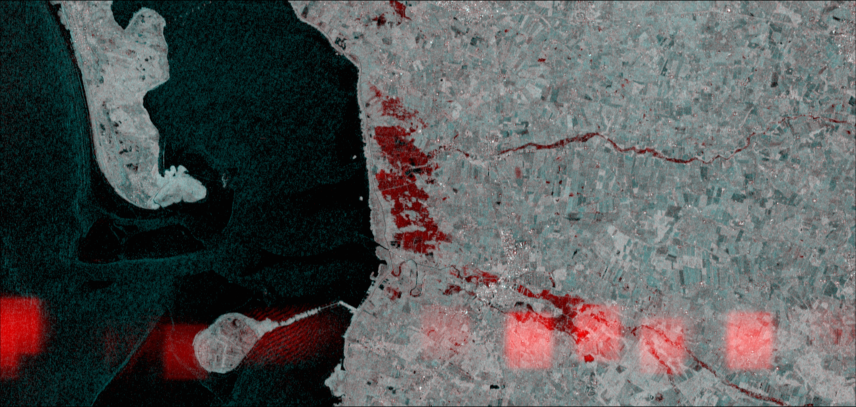

In [106]:
pretty_img(VH,min_vh,max_vh)

In [101]:
data = reshape(flood_band,:)[reshape(rg_result .& bm_mask,:)];
h = StatsBase.fit(StatsBase.Histogram, data,edges)
w_sel = h.weights./w_sum;
w_water_est = gauss_model(y,p_water)
sse = (w_sel .- w_water_est)'*(w_sel .- w_water_est)

6.876702610883637e-6

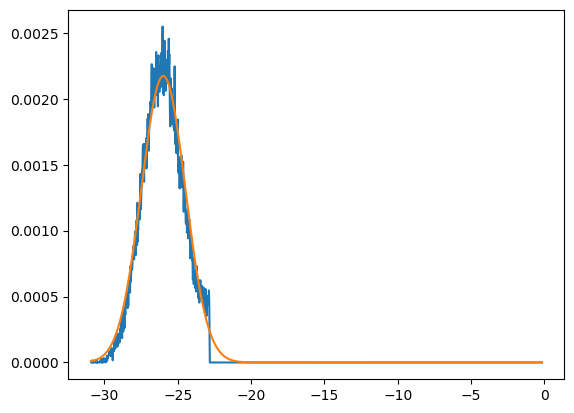

1-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f8af4a03bb0>

In [102]:
PyPlot.figure()
PyPlot.plot(y,w_sel)
PyPlot.plot(y, w_water_est  )